# Notas generales.

- ### 1ro SE HACE Live to Stage y luego Live to Test. Al estar actualizada con datos desde Live, Stage puede ser utilizada para actualizar Test.
- ### Nunca puede faltar el Live to Stage. En ese trabajan los desarrolladores de ASEA.
- ### En Test trabajan los desarrolladores de Xirect.
- ### El paquete de SSIS ejecuta con este server: 10.0.6.5
- ### La copia de la base de datos de Live se hace a mano POR AZURE DATABASES. <mark>Los VIERNES LO MAS TEMPRANO POSIBLE.</mark>
- 

## Excel donde se registran que tablas van en el paquete SSIS.

### <mark>Verificarlo siempre antes de ejecutar el paquete de L2S o L2T.</mark>

[Live To Stage, Stage To Test - ASEA - Google Sheets](https://docs.google.com/spreadsheets/d/15XJvu2Y5wDPVmwPe17kn89NpTXZi0r-ZbHklIER-_PQ/edit?ts=60df6f53#gid=2115945162)

Libro:



# PASO 1: COPIAR LA BASE DE DATOS DE ASEA\_PROD

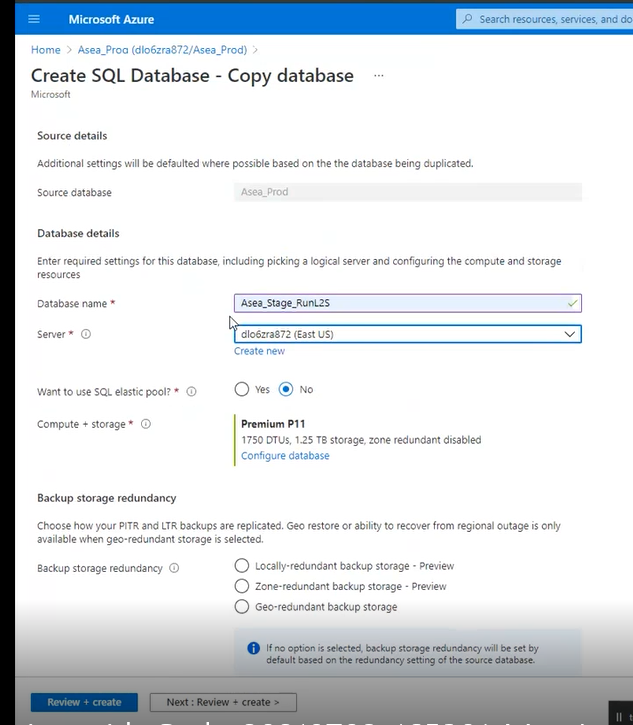



  

## Dos métodos para copiar la base de datos:
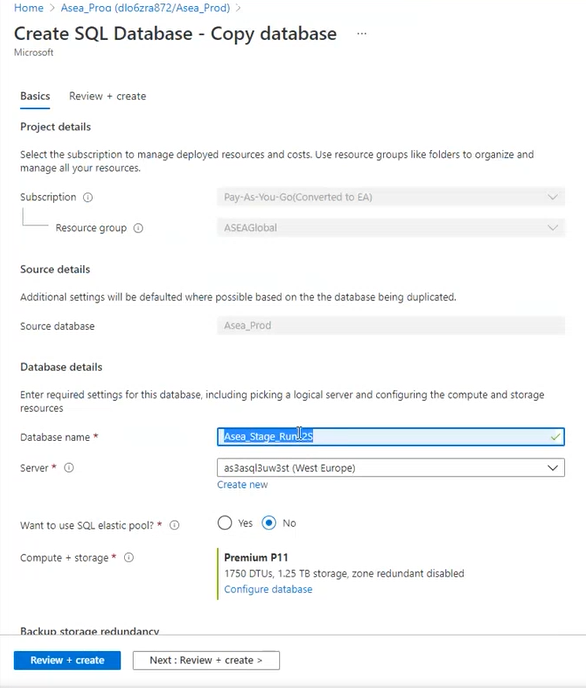
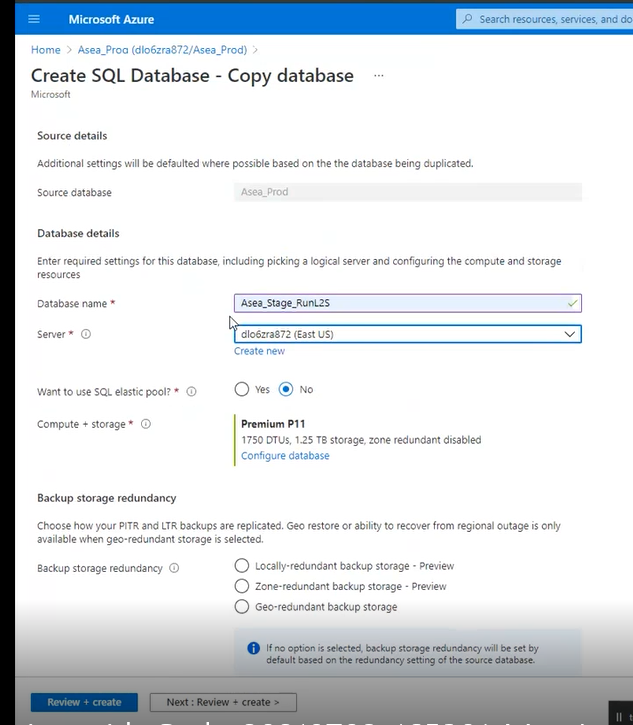
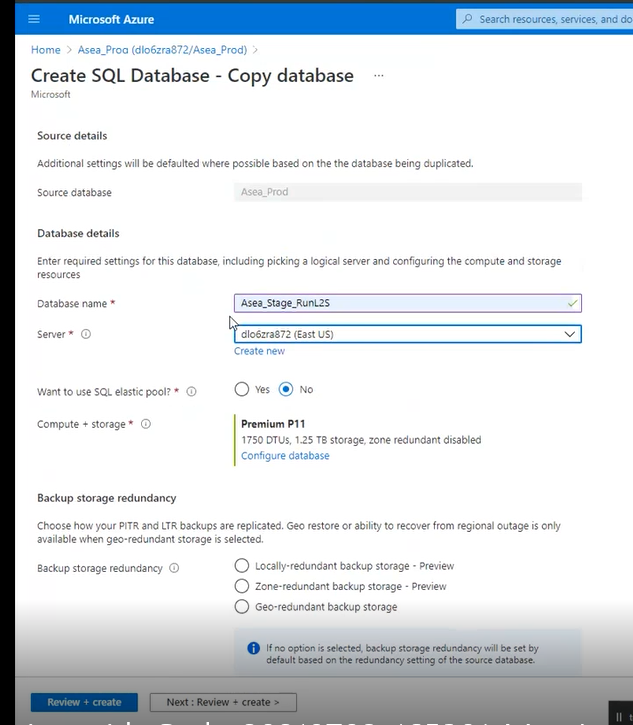
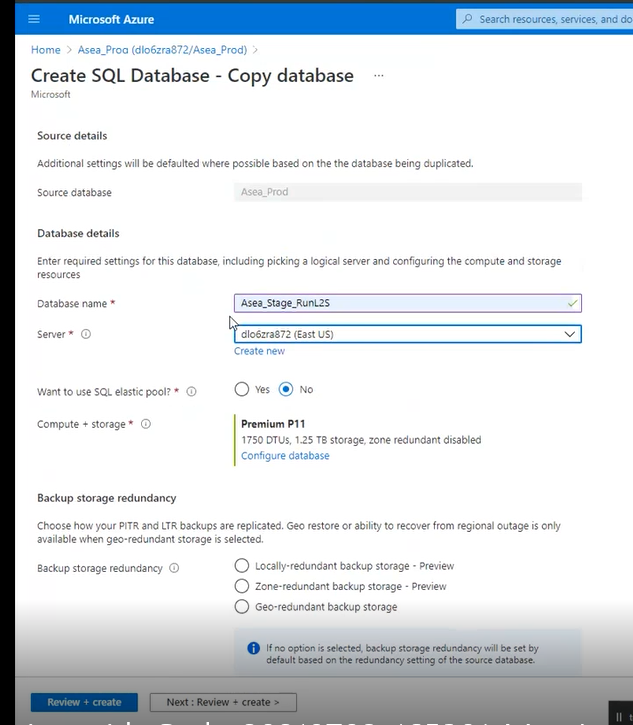
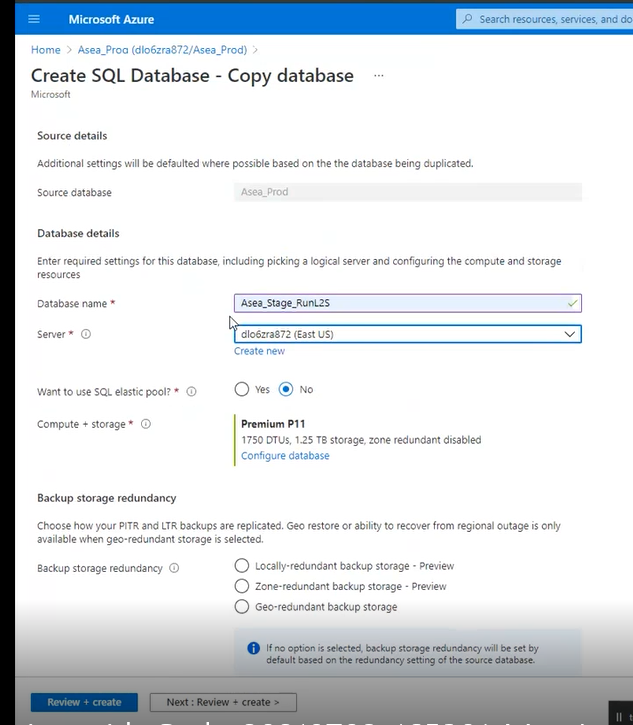
...
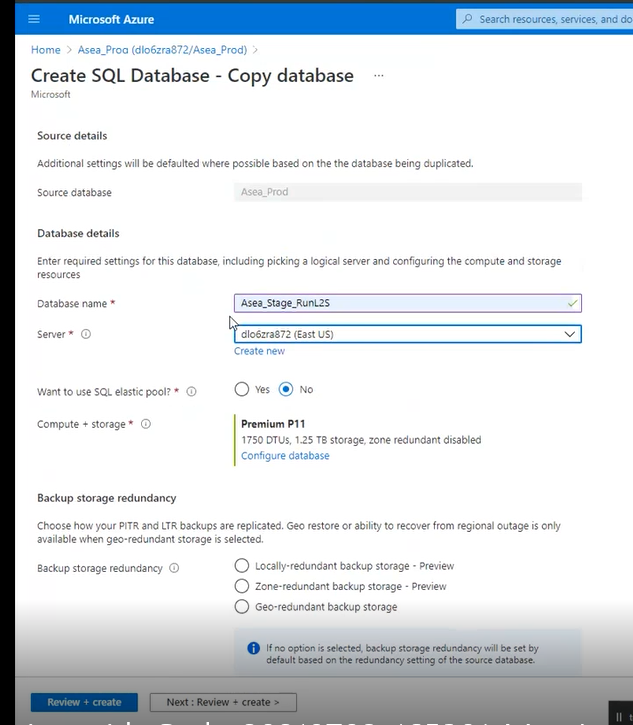
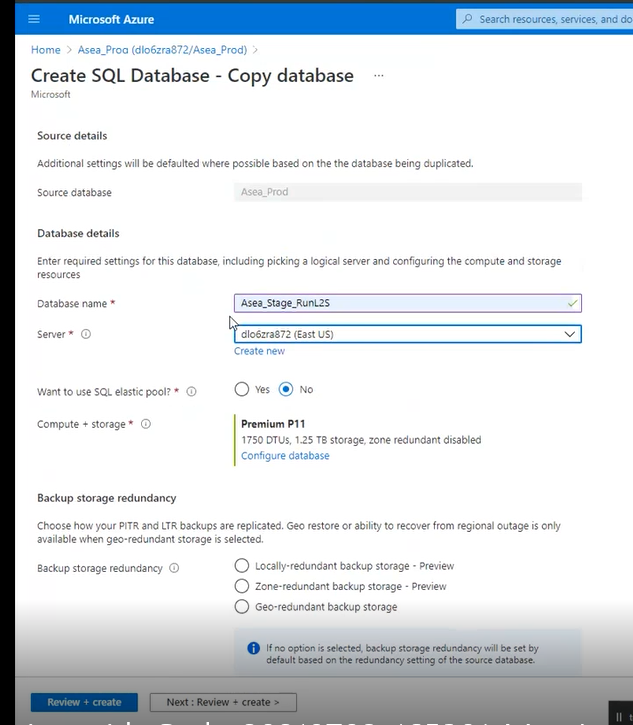
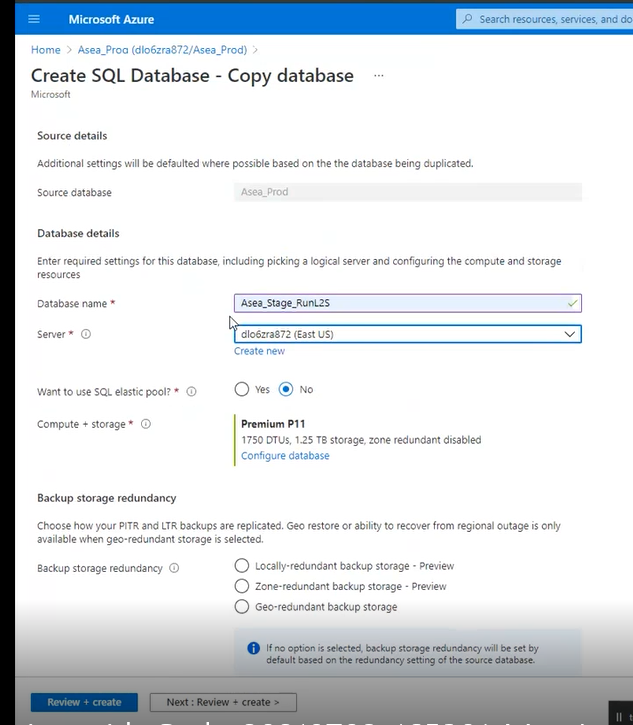
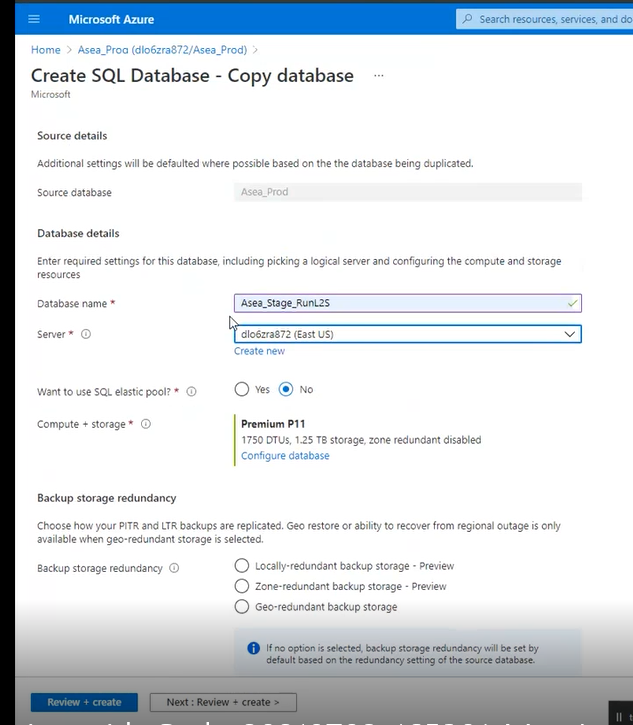
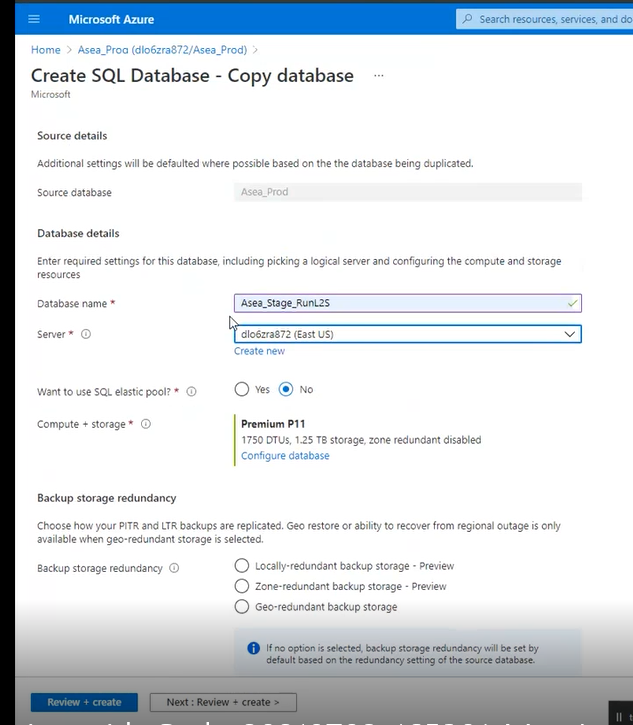

In [ ]:
New-AzSqlDatabaseCopy -ResourceGroupName "Default-SQL-EastUS" -ServerName $sourceserver -DatabaseName "Asea_Prod" `
    -CopyResourceGroupName "Default-SQL-EastUS" -CopyServerName $targetserver -CopyDatabaseName "Asea_Stage_RunL2S"

[Asea\_Prod (dlo6zra872/Asea\_Prod) - Microsoft Azure](https://portal.azure.com/#@softwareasea.onmicrosoft.com/resource/subscriptions/f6d7f502-5128-4fa1-937d-144f1261bed1/resourceGroups/Default-SQL-EastUS/providers/Microsoft.Sql/servers/dlo6zra872/databases/Asea_Prod/overview)

[\-](https://portal.azure.com/#@softwareasea.onmicrosoft.com/resource/subscriptions/f6d7f502-5128-4fa1-937d-144f1261bed1/resourceGroups/Default-SQL-EastUS/providers/Microsoft.Sql/servers/dlo6zra872/databases/Asea_Prod/overview)\-----------------------------------------------------------------------------------

# PASO 2: AVISAR AL GRUPO DE ASEA:
https://teams.microsoft.com/_#/conversations/19:da97392df89f40f9bf9431fa7fe1953e@thread.v2?ctx=chat




# PASO 3. Realizar la comparación de esquemas

## En ASEA las comparaciones se hacen entre bases de datos y no con proyectos.

### La comparación la hace entre la base "vieja" que tiene los cambios de esquema que se quieren preservar y la nueva O LA DE PRODUCCION. Da lo mismo porque la nueva y la de producción son la misma base. <mark>El tema es NO PERDER LOS CAMBIOS EN STAGE</mark> que hicieron los programadores.

Ejemplo de comparación de la nueva contra producción.

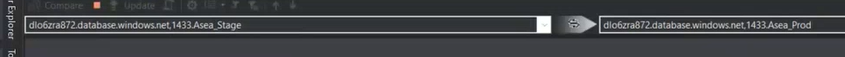
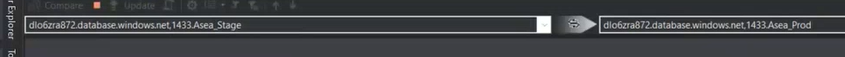
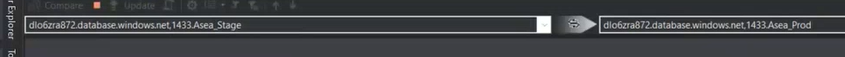
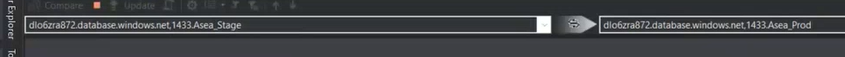
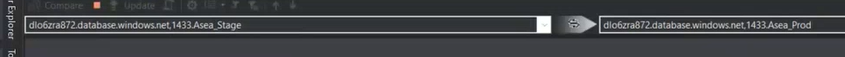
...
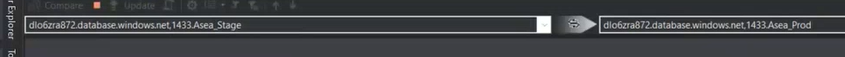
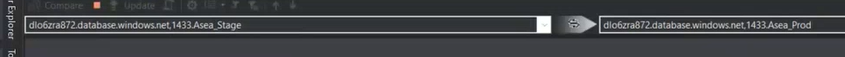
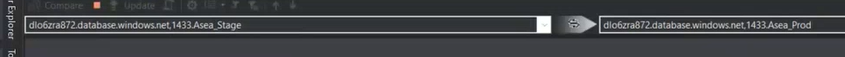
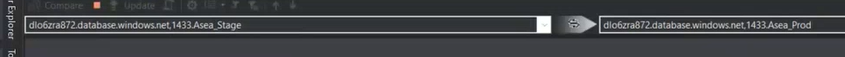
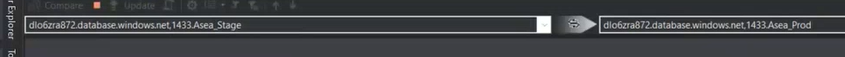

# Paso 4. Generar el script de Cambios

Graly no aplica los cambios directemente desde el visual Studio.  

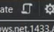

# Paso 5. Copiar EN EL SERVER 10.0.6.5 el script de Cambios

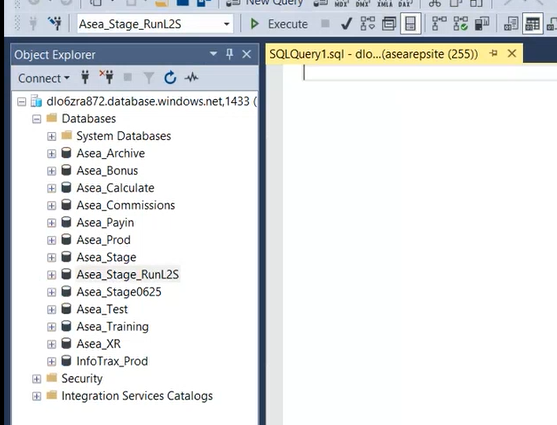
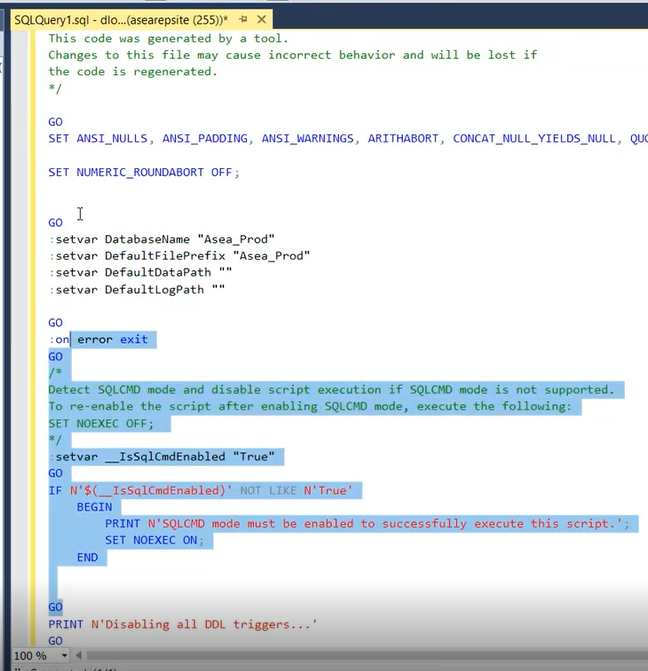
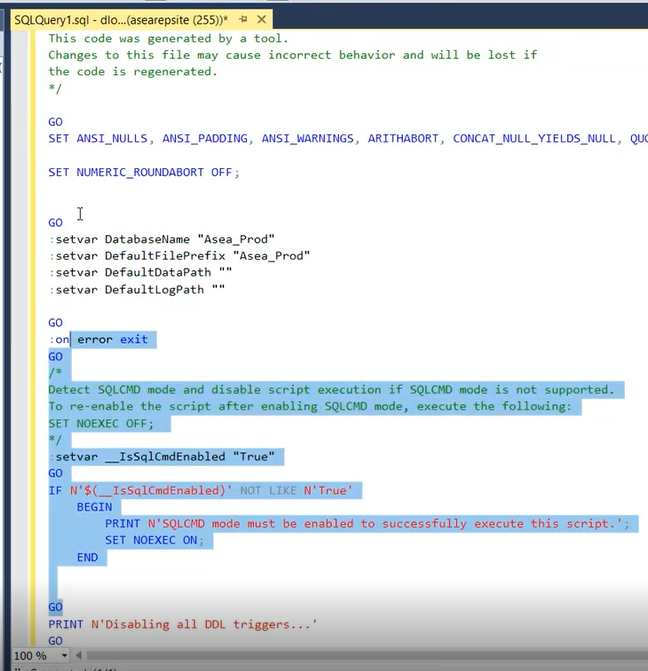
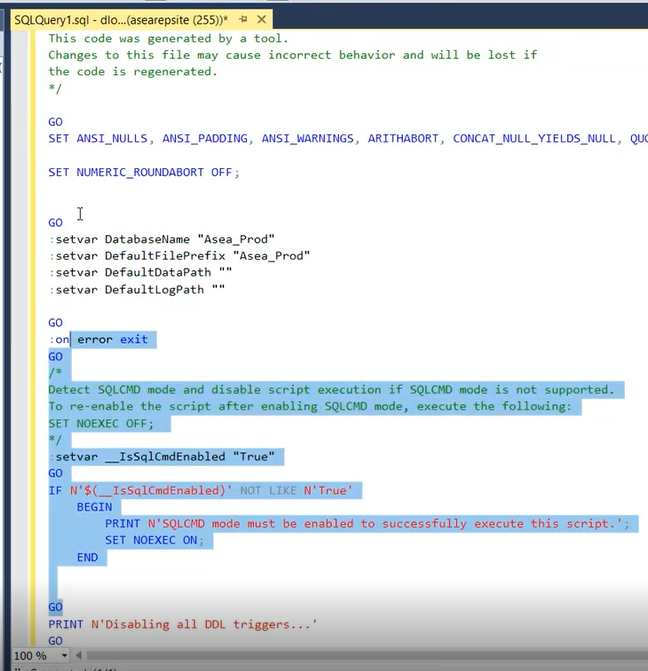
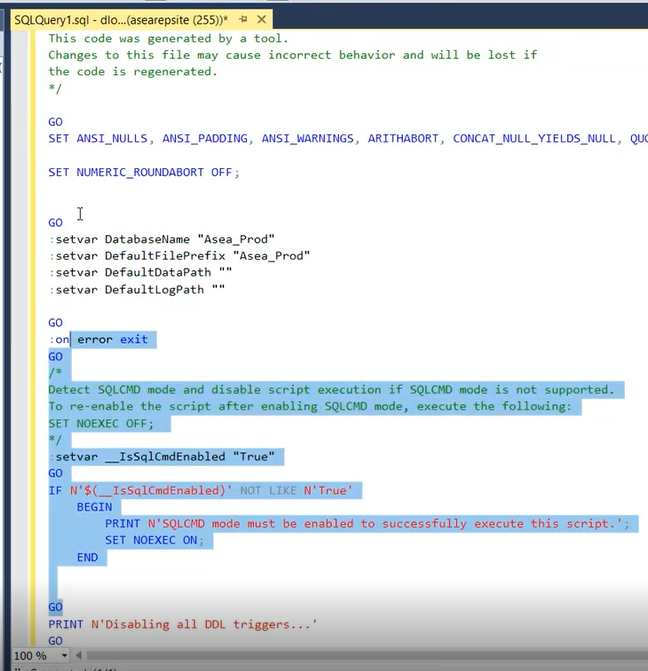
...
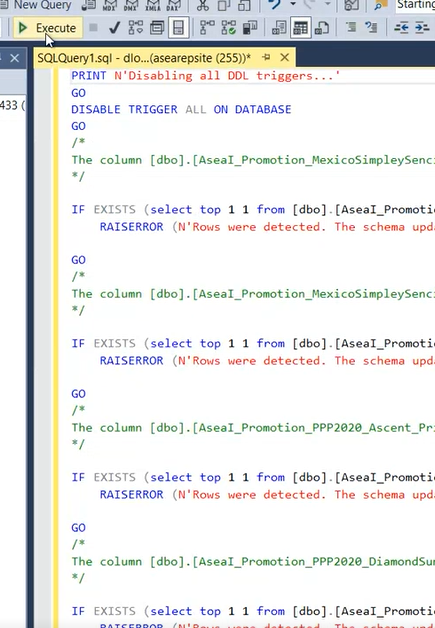
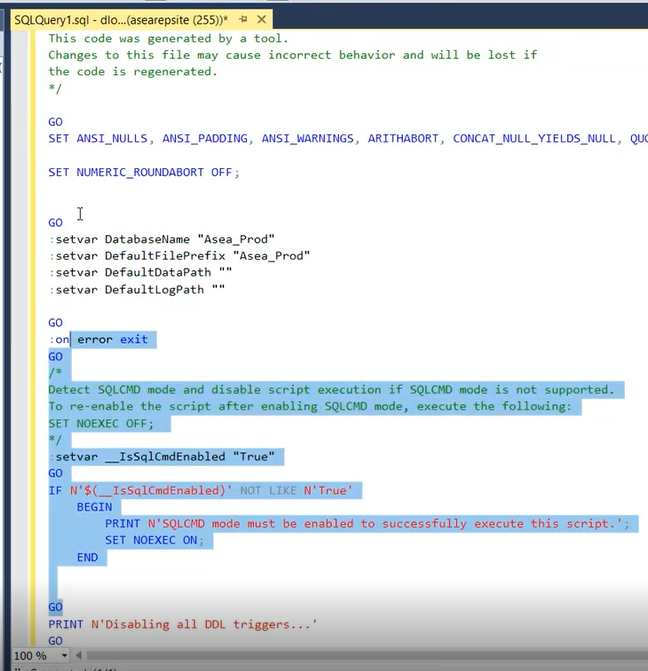
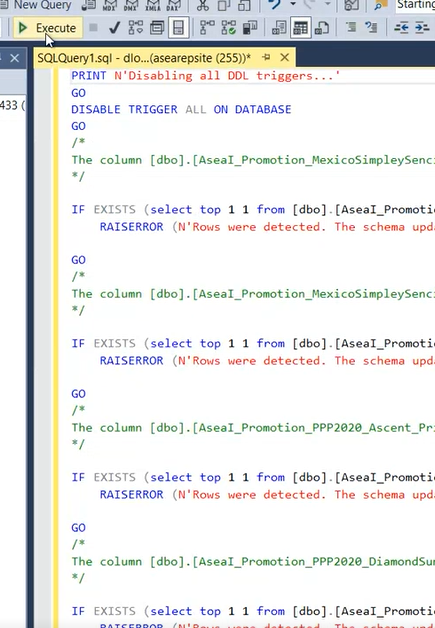
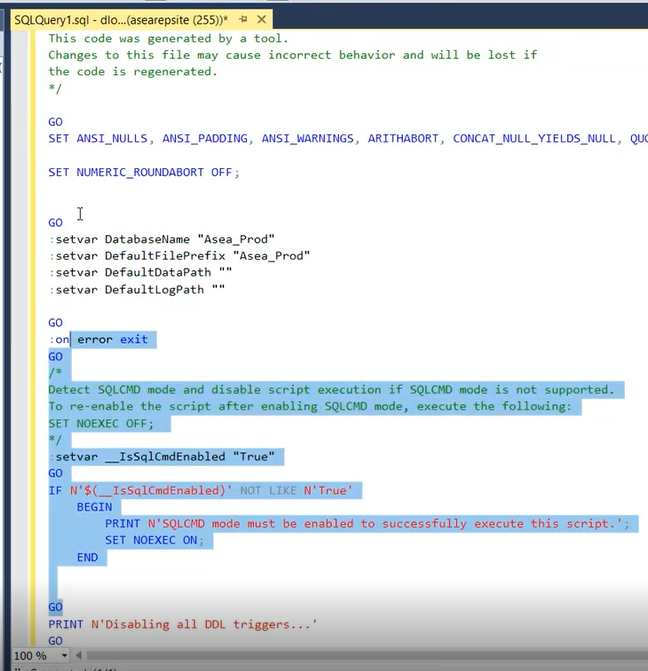
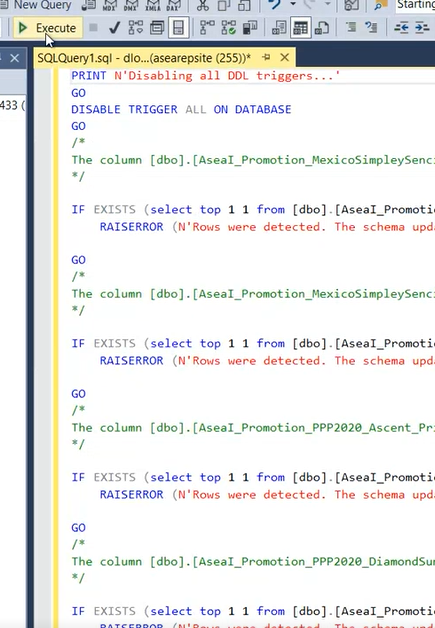

### Deshabilitar hasta donde dice DISABLE TRIGGERS.

  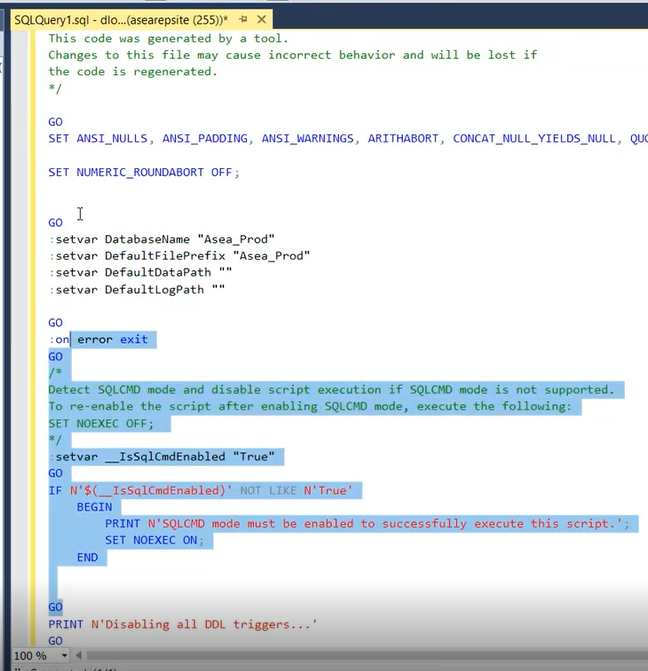  

### Luego ejecutar:

   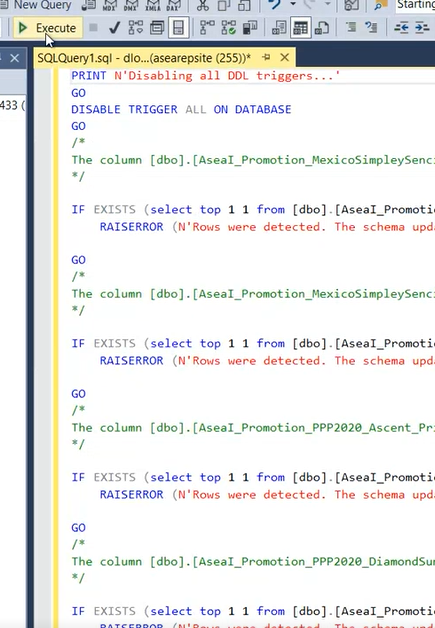
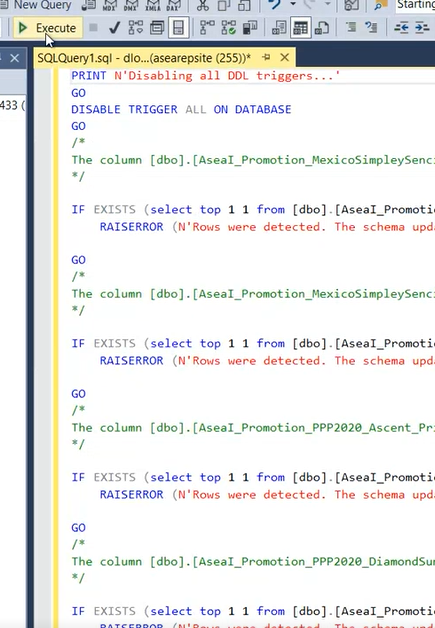
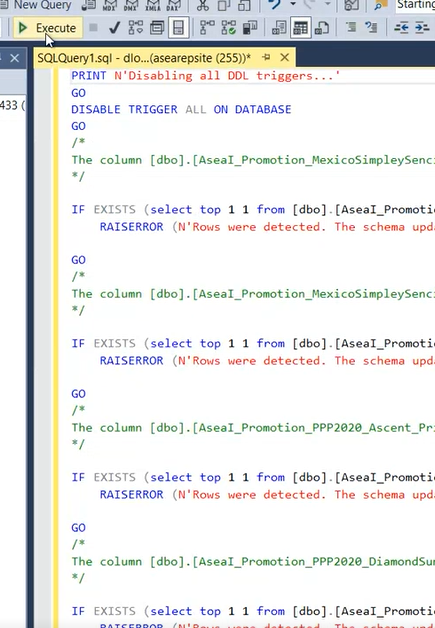
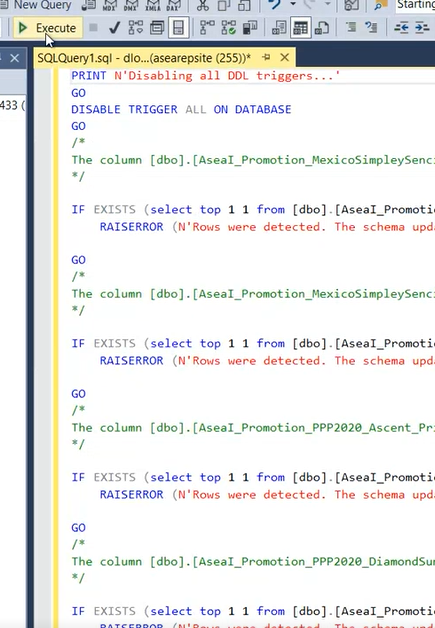
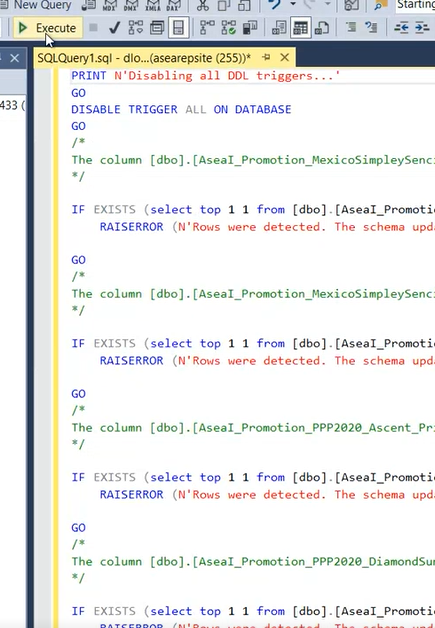
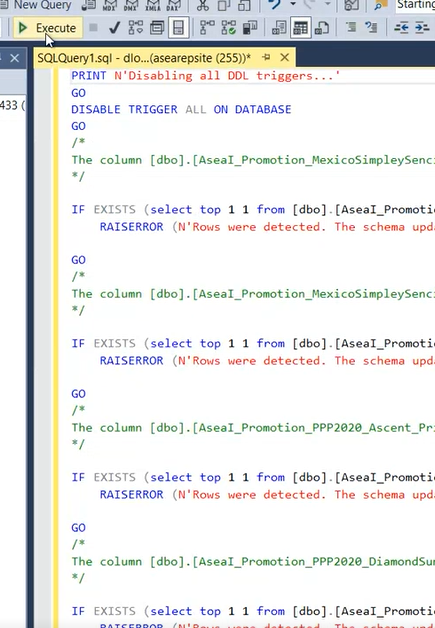
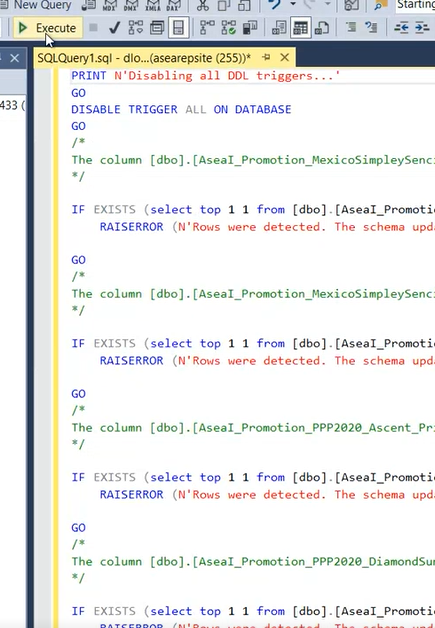
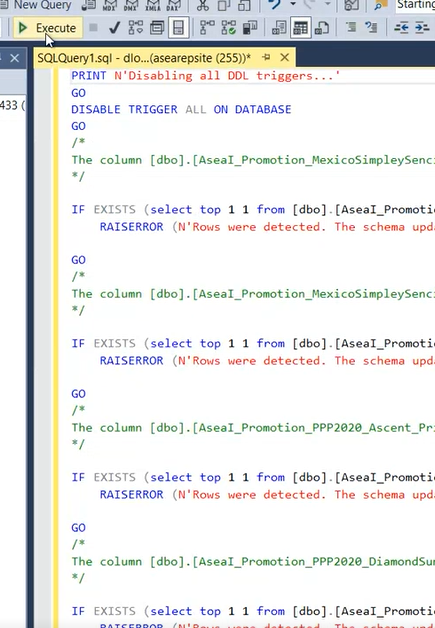

Con la configuración que elije Graly, la ejecución da errores: (no deshabilita la prevención de pérdida de datos)

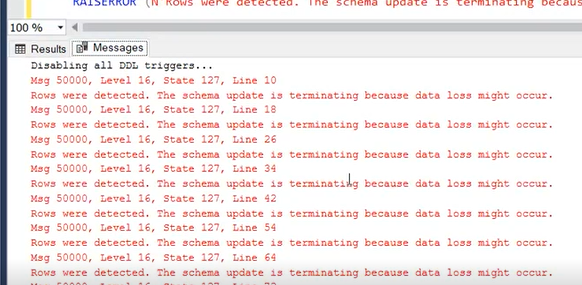

- El script puede demorar 30 minutos.
    
- Cuando se modifican tablas grandes, el script demora mas. Graly lo detiene y saltea la parte de esa modificación. En ese caso, parar el proceso, borrar desde la sentencia que demora hasta arriba de todo porque eso ya corrió ok  y continuar el script. Luego correr el ALTER TABLE a mano (hacerlo) relacionado con la tabla que demoró el proces. Esto es porque el Schema Compare hace como el SSMS, genera otra tablas y luego pasa los datos. De esa forma tarda mucho mas. Si la tabla es de LOG, se puede truncar.  
    Verificar en el documento [Live To Stage, Stage To Test - ASEA - Google Sheets](https://docs.google.com/spreadsheets/d/15XJvu2Y5wDPVmwPe17kn89NpTXZi0r-ZbHklIER-_PQ/edit?ts=60df6f53#gid=2115945162) quien creó la tabla porque demora la ejecución del script. Preguntarle al desarrollador de esa tabla si realmente se necesita esa data.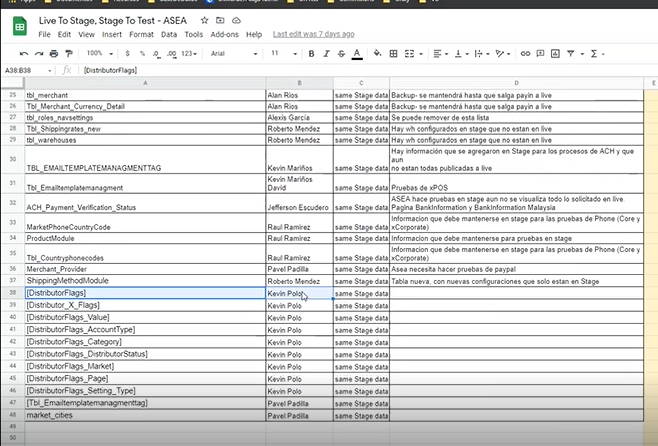  
    Si el desarrollador necesita la data entonces se puede crear la tabla vacía con los cambios y luego hacer un paquete de SSIS para pasar toda la data que necesita el desarrollador.
    
- Hay veces que los errores YA ESTAN EN STAGE (el viejo) y cuando ejecutás el script de cambios la ejecución da error pero es porque ese error ya venía de antes. En ese caso ver en la cabeza del SP de quien es y mandarle el error y el script del CREATE PROC.
    
-

Ejecutando el script puede dar errores como este, el cual ya está reportado. Es un error de la gente de desarrollo de ASEA:

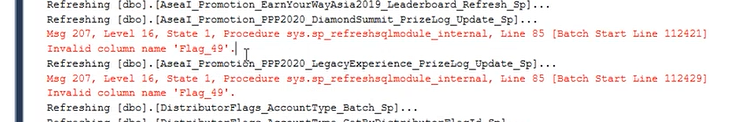

Los SPs de la gente de ASEA a comienzan con ASEA. Los SPs de ASEA que dan errores hay que hacer un backup y pasarlo a Jake.

<mark>\### Importante: hay que revisar todo el resultado de la ejecución del Script. GUARDAR EL SCRIPT DE CAMBIOS por si acaso.</mark>

# Paso 6. Paquete de SSIS

Graly hace un REBUILD para detectar alguna inconsistencia antes de ejecutar el paquete.

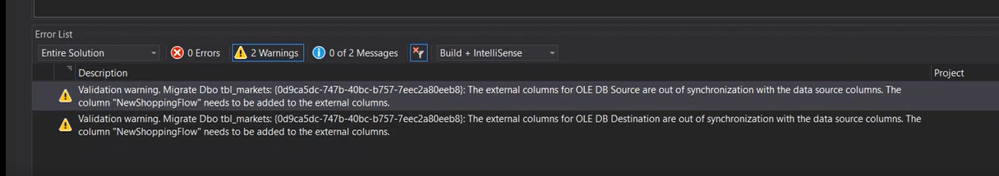

  

Detecta cuando hay cambios en columnas. El excel de tambios sirva para cuando hay tablas nuevas o se borrar tablas.
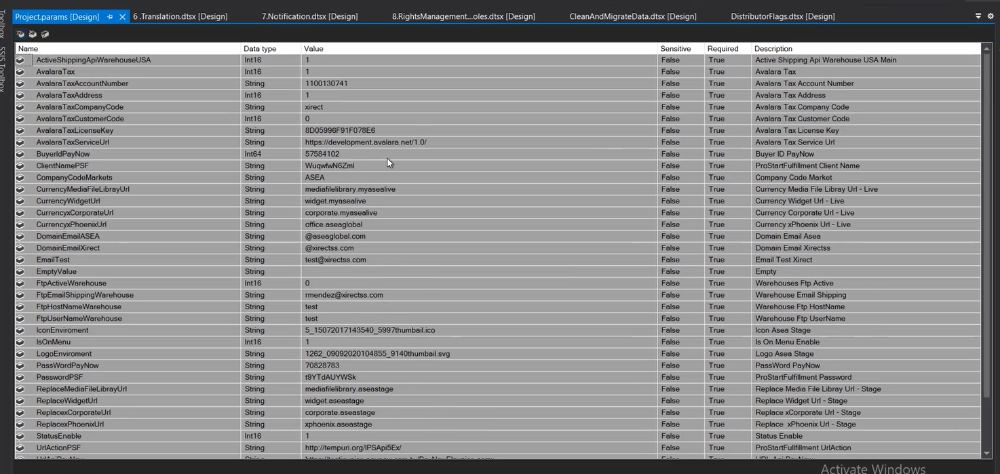
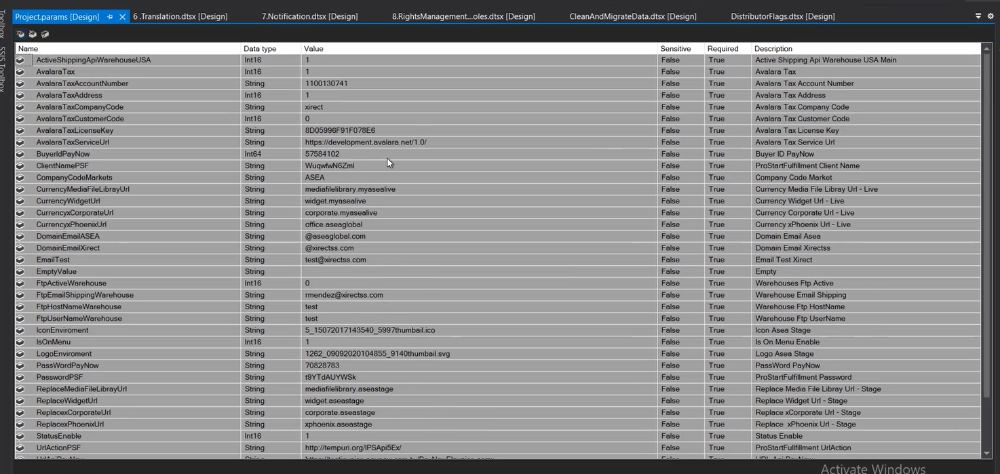
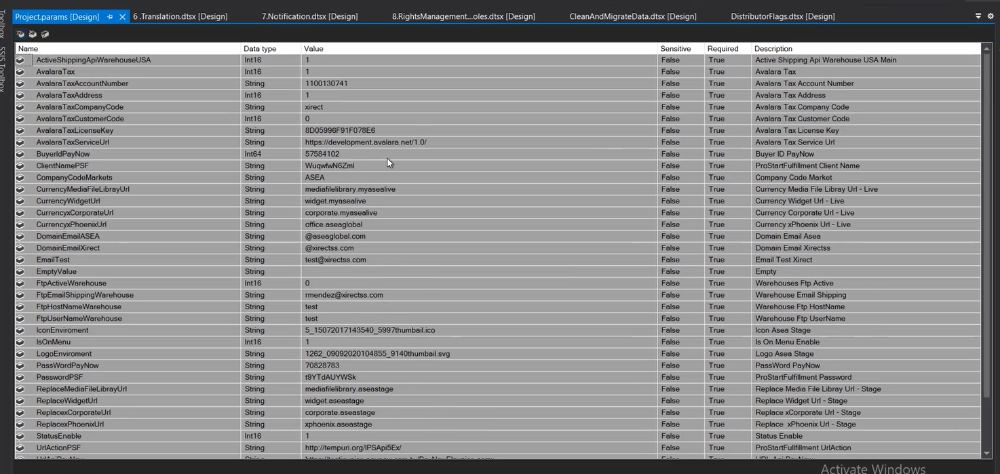
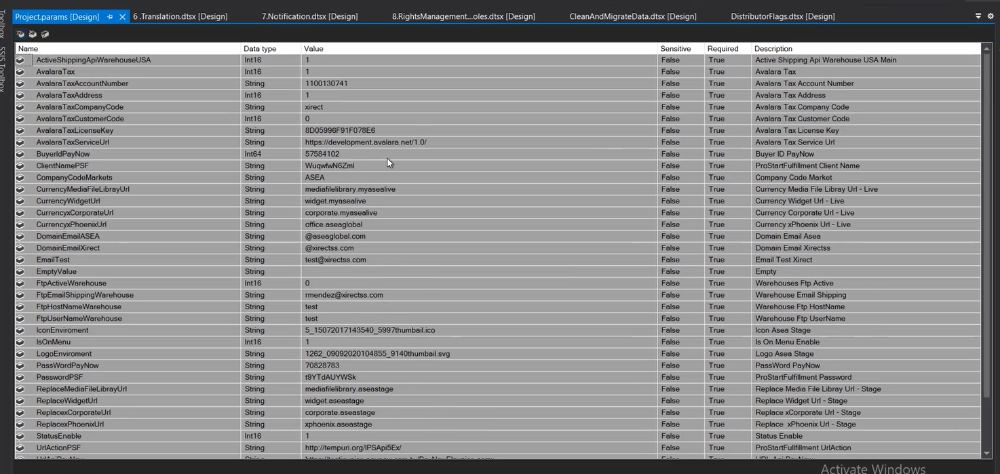
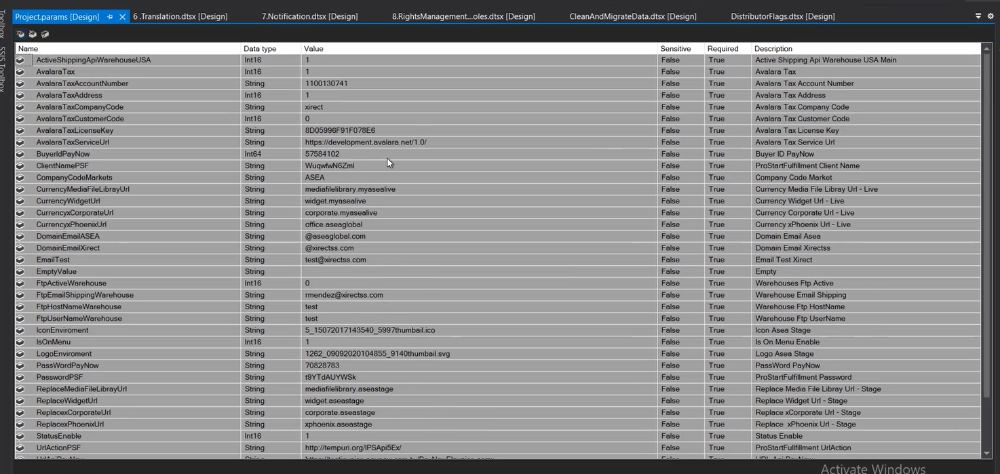

De acá no se toca nada:

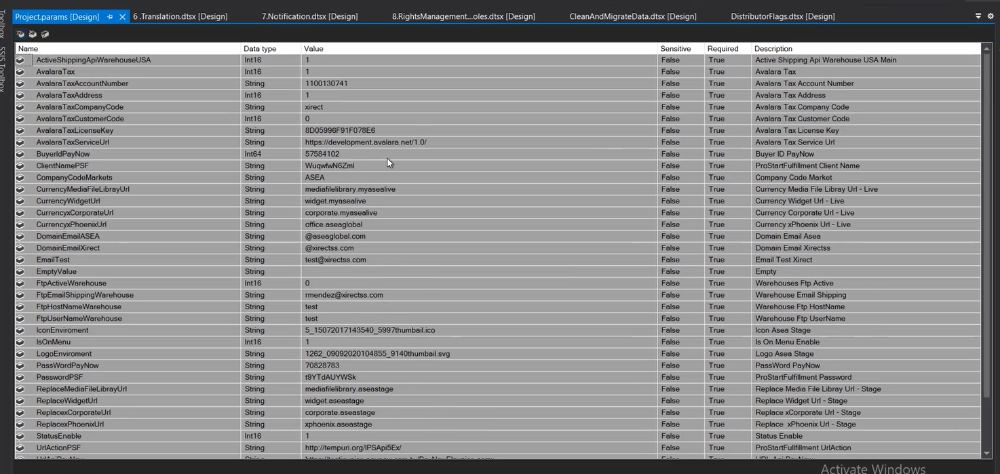

Paquetes a ejecutar:

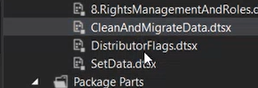
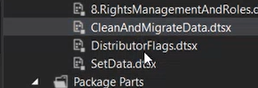
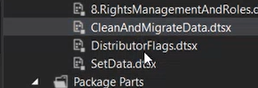
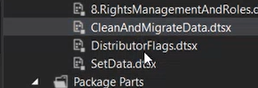
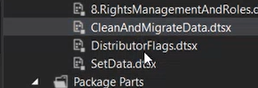
...
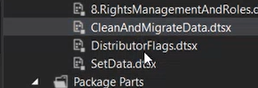
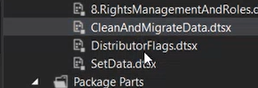
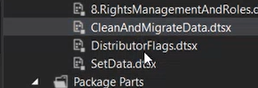
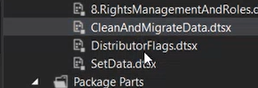
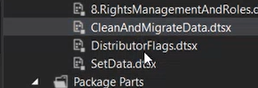

Ejecutar:

1. CleanAndMigrateData
2. SetData.dtsx

Descomentar script y cambiar fecha del backup ccon MES y DIA:

In [ ]:
--ALTER DATABASE Asea_Stage 
--Modify Name = Asea_Stage1106; 
--GO 
--ALTER DATABASE Asea_Stage_RunL2S 
--Modify Name = Asea_Stage; 
--GO

Eliminar en el backup:

Drop Trigger \[Database\_DenyAlterOrDropTable\_Tr\] On Database

drop procedure Commission\_Engine\_Set\_Rankbyid\_Sp

drop function \[Commission\_Engine\_Rankvalidation\_Fn\]

drop table Om\_Distributorranks

drop table \[tbl\_Orders\_Header\_Snapshot\_mem\]

Y pasarlo a S3.